## Additional maps
A workspace that I use for creating maps beyond those in the tutorial (such as maps of specific travels)

In [1]:
import time
start_time = time.time() # Allows the program's runtime to be measured
import os
import pandas as pd
import datetime
import matplotlib.pyplot as plt
import IPython.display
from IPython.display import display

from media_geotag_functions_v2 import generate_media_list, \
    retrieve_pic_locations, retrieve_clip_locations, generate_loc_list, \
    map_media_locations, folder_list_to_map, flip_lon, create_map_screenshot, \
    calculate_distance_by_year, convert_png_to_smaller_jpg, \
    batch_create_map_screenshots, batch_convert_pngs_to_smaller_jpgs

In [2]:
folder_name = 'extra_files\co_aspen_snowmass_outdoors' # You can't precede
# the backslash with certain letters, such as 'a' or 'n', or otherwise the
# program will get confused.
file_name = 'aspen_snowmass_outdoors'

top_folder_list = [
r'D:\Temp storage\Temp videos for projects\2022-03 Outdoor Aspen Snowmass views']

In [3]:
generate_new_lists = True
if generate_new_lists == True:
    df_media = generate_media_list(top_folder_list=top_folder_list,
    folder_name = folder_name)
    df_all_locations = generate_loc_list(df_media = df_media, 
    folder_name = folder_name)

Retrieving picture locations:


0it [00:00, ?it/s]


Retrieving clip locations:


100%|██████████| 78/78 [00:04<00:00, 19.03it/s]


In [4]:
df_media = pd.read_csv(f'{folder_name}_media_list.csv')
df_media.head(5)

,path,name,ctime,modified_time,accessed_time,megabytes,extension,type
0,D:\Temp storage\Temp videos for projects\2022-...,20220303_114902.mp4,2022-06-09 15:54:32,2022-03-03 11:49:07,2022-06-09 17:01:09,38.724083,mp4,clip
1,D:\Temp storage\Temp videos for projects\2022-...,20220303_114909.mp4,2022-06-09 15:54:32,2022-03-03 11:49:14,2022-06-09 17:04:48,42.023359,mp4,clip
2,D:\Temp storage\Temp videos for projects\2022-...,20220303_114916.mp4,2022-06-09 15:54:32,2022-03-03 11:49:20,2022-06-09 17:04:50,36.817490,mp4,clip
3,D:\Temp storage\Temp videos for projects\2022-...,20220303_115000.mp4,2022-06-09 15:54:32,2022-03-03 11:50:05,2022-06-09 17:04:52,45.788553,mp4,clip
4,D:\Temp storage\Temp videos for projects\2022-...,20220303_115119.mp4,2022-06-09 15:54:32,2022-03-03 11:51:28,2022-06-09 17:04:55,80.618266,mp4,clip


In [5]:
df_all_locations = pd.read_csv(f'{folder_name}_media_locations.csv')

In [6]:
df_all_locations

,path,name,ctime,modified_time,accessed_time,megabytes,extension,type,raw_location,lat,lon,alt_capture_time
0,D:\Temp storage\Temp videos for projects\2022-...,20220303_114902.mp4,2022-06-09 15:54:32,2022-03-03 11:49:07,2022-06-09 17:01:09,38.724083,mp4,clip,+00.0000+000.0000/,0.0000,0.0000,x
1,D:\Temp storage\Temp videos for projects\2022-...,20220303_114909.mp4,2022-06-09 15:54:32,2022-03-03 11:49:14,2022-06-09 17:04:48,42.023359,mp4,clip,+00.0000+000.0000/,0.0000,0.0000,x
2,D:\Temp storage\Temp videos for projects\2022-...,20220303_114916.mp4,2022-06-09 15:54:32,2022-03-03 11:49:20,2022-06-09 17:04:50,36.817490,mp4,clip,+00.0000+000.0000/,0.0000,0.0000,x
3,D:\Temp storage\Temp videos for projects\2022-...,20220303_115000.mp4,2022-06-09 15:54:32,2022-03-03 11:50:05,2022-06-09 17:04:52,45.788553,mp4,clip,+00.0000+000.0000/,0.0000,0.0000,x
4,D:\Temp storage\Temp videos for projects\2022-...,20220303_115119.mp4,2022-06-09 15:54:32,2022-03-03 11:51:28,2022-06-09 17:04:55,80.618266,mp4,clip,+39.1512-106.8197/,39.1512,-106.8197,x
...,...,...,...,...,...,...,...,...,...,...,...,...
73,D:\Temp storage\Temp videos for projects\2022-...,20220305_130710.mp4,2022-06-09 15:57:51,2022-03-05 15:07:17,2022-06-09 17:02:49,61.132697,mp4,clip,+00.0000+000.0000/,0.0000,0.0000,x
74,D:\Temp storage\Temp videos for projects\2022-...,20220305_151414.mp4,2022-06-09 15:57:51,2022-03-05 17:14:20,2022-06-09 17:02:52,48.670037,mp4,clip,+39.2065-106.9517/,39.2065,-106.9517,x
75,D:\Temp storage\Temp videos for projects\2022-...,20220305_151422.mp4,2022-06-09 15:57:51,2022-03-05 17:14:26,2022-06-09 17:02:54,33.386608,mp4,clip,+39.2065-106.9517/,39.2065,-106.9517,x
76,D:\Temp storage\Temp videos for projects\2022-...,20220305_151920.mp4,2022-06-09 15:57:51,2022-03-05 17:19:24,2022-06-09 17:02:56,35.880855,mp4,clip,+39.2072-106.9463/,39.2072,-106.9463,x


In [7]:
absolute_path_to_map_folder = \
r'C:\Users\kburc\D1V1\Documents\!Dell64docs\Programming\py\kjb3_programs\media_geotag_mapper\extra_maps'
screenshot_save_path = 'extra_map_screenshots'

In [31]:
map = map_media_locations(df_all_locations, folder_path = 'extra_maps', tiles = 'Stamen Terrain',
file_name = file_name, starting_location = [39.17, -106.87], zoom_start = 14, add_paths = True)
map

Added 65 markers to the map.


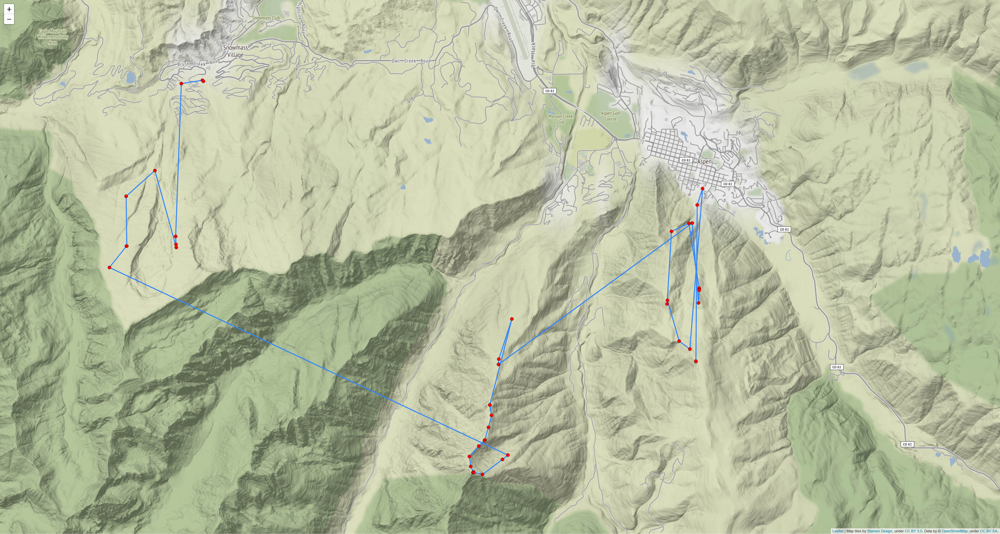

In [27]:
create_map_screenshot(absolute_path_to_map_folder = 
absolute_path_to_map_folder, map_name= file_name+'_locations.html', 
screenshot_save_path = screenshot_save_path)

IPython.display.display(IPython.display.Image(
    filename=screenshot_save_path+'\\'+file_name+'_locations.png'))
# This code is based on DrMcCleod's response at:
# https://stackoverflow.com/a/35061341/13097194